In [1]:
from fastspeech.modules import FastSpeech, FFTConfig, DPConfig
from fastspeech.data import *
from fastspeech.training import *
from fastspeech.visualize import *
from fastspeech.preprocess import ZScoreNormalization, MinMaxNormalization
from torch.utils.data import DataLoader
from torch.optim import Adam
import torch.nn.functional as F
from functools import partial
from pathlib import Path
import json
import torch

In [2]:
path = Path("../../data/LJSpeech-1.1/")
path_vocab = Path("../../data/CMUDict/cmudict-0.7b.symbols.txt")
path_stats = Path("../sample_data/lj_mel_stats.json")

In [3]:
with open(path_stats, 'r') as f: stats = json.load(f)

In [4]:
stats = {key: float(stats[key]) for key in stats}
stats["top_db"] = 35
stats

{'min_val': -0.000100009995,
 'max_val': 12.625555,
 'mean': 0.0021890362,
 'std': 0.02285596,
 'top_db': 35}

In [5]:
cut = None
# cut = int(13084*.01)
ds = TTSDataset(path, path_vocab, ZScoreNormalization, ds=slice(cut), 
                preload=True, stats=stats)

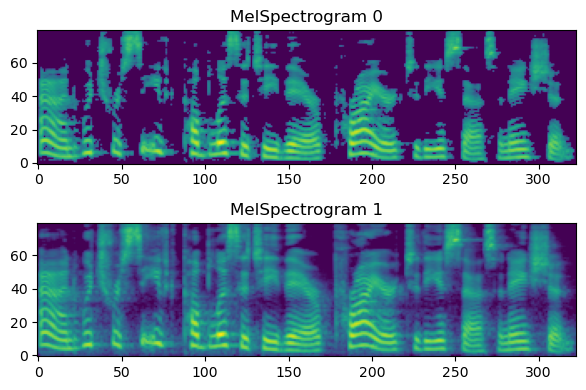

In [6]:
normalized = ds.mels[0]
denormalized = ds.norm.denormalize(normalized)
show_mels([normalized, denormalized])

In [16]:
bs = 48
n_workers = 2
pres_worker = True

collate_fn_p = partial(collate_fn, pad_num=ds.vocab.pad_num, norm=ds.norm)
dl = DataLoader(ds, bs, shuffle=True, num_workers=n_workers, pin_memory=True,
                collate_fn=collate_fn_p, persistent_workers=pres_worker, drop_last=True)

In [17]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

device(type='cuda')

In [18]:
log_interval = 1000
ni = 256
clip = 10.
config = {
    "model": {
        "ne": len(ds.vocab.vocab), "ni": ni, "no": 80, 
        "ec": FFTConfig(ni=ni, nh=2, fs=1024, ks=[9,1], p=[0.1,0.1]), "enb": 4, 
        "dc": FFTConfig(ni=ni, nh=2, fs=1024, ks=[9,1], p=[0.1,0.1]), "dnb": 4, 
        "dpc": DPConfig(ni=ni, fs=256, ks=[3,3], p=[0.1,0.1]),
        "device": device
    },
    "optim": {"lr":  1e-5, "betas": (0.9, 0.98), "eps": 1e-10, "weight_decay": 0},
    "scheduler": {"lr_mul": 1., "d_model": ni, "n_warmup_steps": 4000},
}

learner = FastspeechLearner(dl, ds.norm, FastSpeech, Adam, TransformerScheduler, 
                            config, mae_loss, F.mse_loss, fp_16=False, grad_clip=clip, 
                            device=device, log_interval=log_interval)

In [19]:
count_parameters(learner.model)

23532881

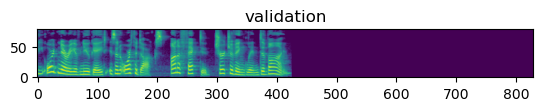

Training:   0%|          | 0/200000 [00:00<?, ?step/s]

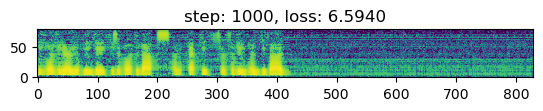

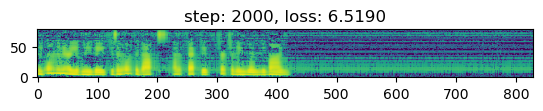

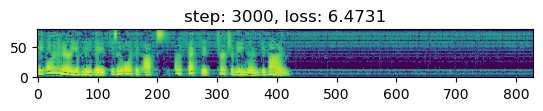

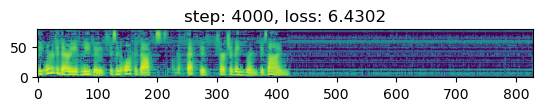

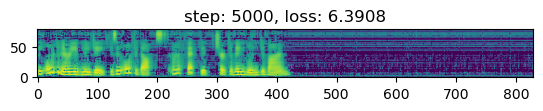

...

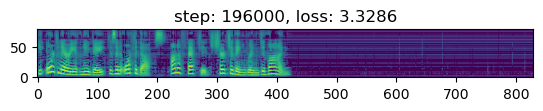

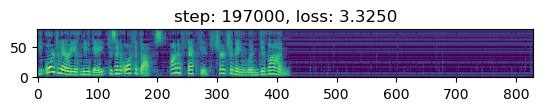

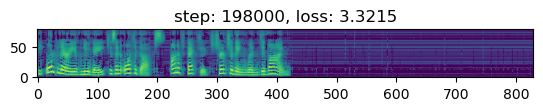

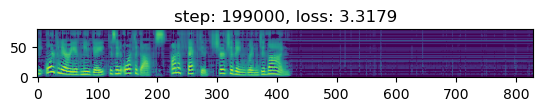

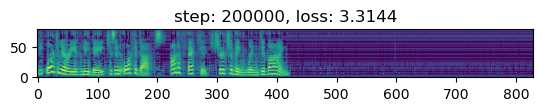

In [20]:
steps = 200000
learner.fit(steps)

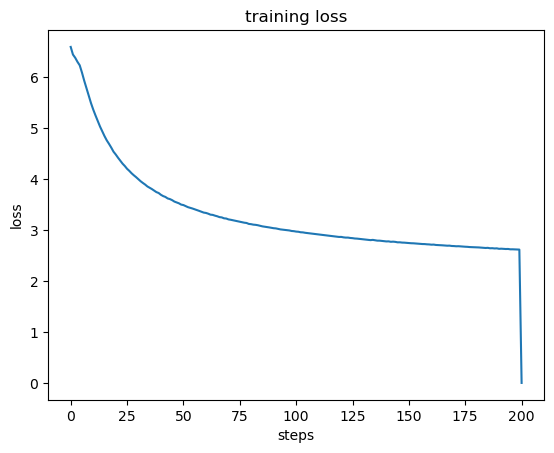

In [21]:
plot_loss([sum(learner.loss_history['a'][i:i+1000]) / 1000 
           for i in range(0, len(learner.loss_history['a']), 1000)])

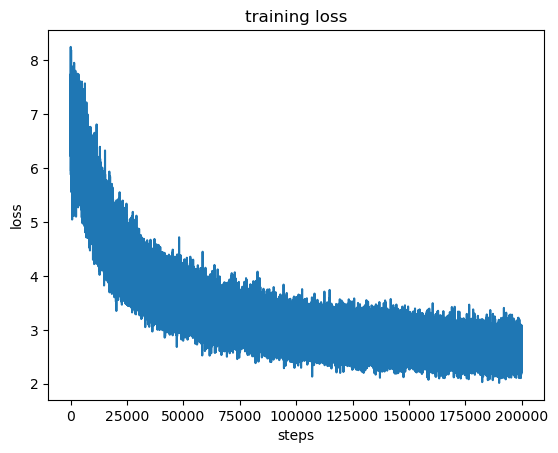

In [22]:
plot_loss(learner.loss_history['a'])

In [23]:
mels = list(map(lambda x: x[0], learner.mel_history))

In [24]:
ani = MelAnimation(mels)

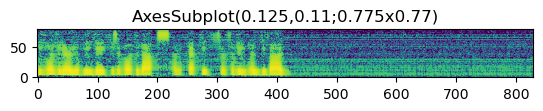

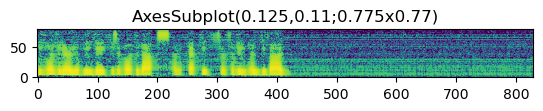

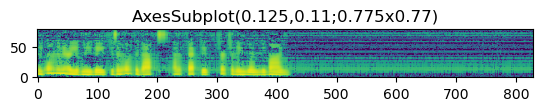

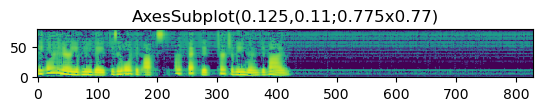

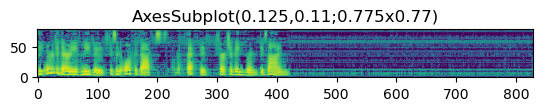

...

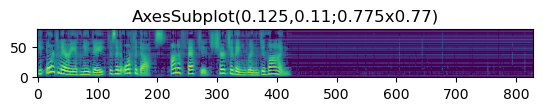

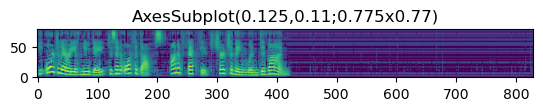

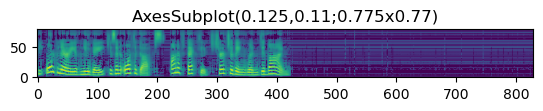

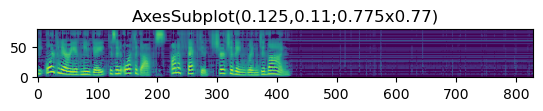

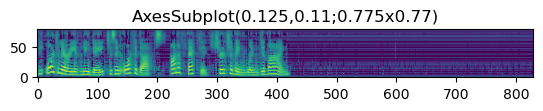

In [25]:
ani.animate_mels()